In [248]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats
import statsmodels.formula.api as smf
import plotly.express as px
import geopandas as gpd
import plotly.io as pio
pio.renderers.default = "vscode"

In [249]:
df = pd.read_csv("../data/processed/BaseCLD2026_clean.csv")

df.shape

(31126, 28)

In [250]:
df.head()
df.info()

<class 'pandas.DataFrame'>
RangeIndex: 31126 entries, 0 to 31125
Data columns (total 28 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   ID                      31126 non-null  int64  
 1   ANNEE                   31126 non-null  int64  
 2   COMMU_LAB               30828 non-null  str    
 3   RAIN                    31126 non-null  str    
 4   Sol_simple              31052 non-null  str    
 5   type_sol                31126 non-null  str    
 6   Date_prelevement        31126 non-null  str    
 7   Date_enregistrement     31126 non-null  str    
 8   Date_analyse            28424 non-null  str    
 9   Operateur_chld          31126 non-null  str    
 10  Taux_Chlordecone        31126 non-null  float64
 11  Operateur_5b            31126 non-null  str    
 12  Taux_5b_hydro           31103 non-null  float64
 13  histoBanane_Histo_ban   13143 non-null  float64
 14  mnt_tpi_mean            31126 non-null  float64
 

# Analyse de Contamination par commune

In [251]:
communes = (
    df.groupby("COMMU_LAB")
      .agg(
          n_obs=("ID", "count"),
          moyenne=("Taux_Chlordecone_clean", "mean"),
          mediane=("Taux_Chlordecone_clean", "median"),
          taux_censure=("chl_censure", "mean")
      )
      .sort_values("moyenne", ascending=False)
)

communes.head(10)

,n_obs,moyenne,mediane,taux_censure
COMMU_LAB,,,,
MORNE-ROUGE(LE),3725,2.800207,2.75800,0.175570
GRAND'RIVIERE,125,1.839615,0.33630,0.200000
MACOUBA,698,1.696628,1.50000,0.000000
BASSE-POINTE,992,1.380820,0.09000,0.134073
TRINITE(LA),1101,0.683778,0.06000,0.337875
MARIGOT(LE),475,0.612896,0.12500,0.166316
LORRAIN(LE),1763,0.581340,0.18500,0.117413
SAINT-PIERRE,339,0.560821,0.00530,0.436578
GROS-MORNE,2093,0.546092,0.00165,0.498328


### Filtrer les communes robustes 
Nous évitons les communes avec peu d’observations 

In [252]:
communes = communes[communes["n_obs"] >= 30]
communes.head(10)

,n_obs,moyenne,mediane,taux_censure
COMMU_LAB,,,,
MORNE-ROUGE(LE),3725,2.800207,2.75800,0.175570
GRAND'RIVIERE,125,1.839615,0.33630,0.200000
MACOUBA,698,1.696628,1.50000,0.000000
BASSE-POINTE,992,1.380820,0.09000,0.134073
TRINITE(LA),1101,0.683778,0.06000,0.337875
MARIGOT(LE),475,0.612896,0.12500,0.166316
LORRAIN(LE),1763,0.581340,0.18500,0.117413
SAINT-PIERRE,339,0.560821,0.00530,0.436578
GROS-MORNE,2093,0.546092,0.00165,0.498328


### Visualisation

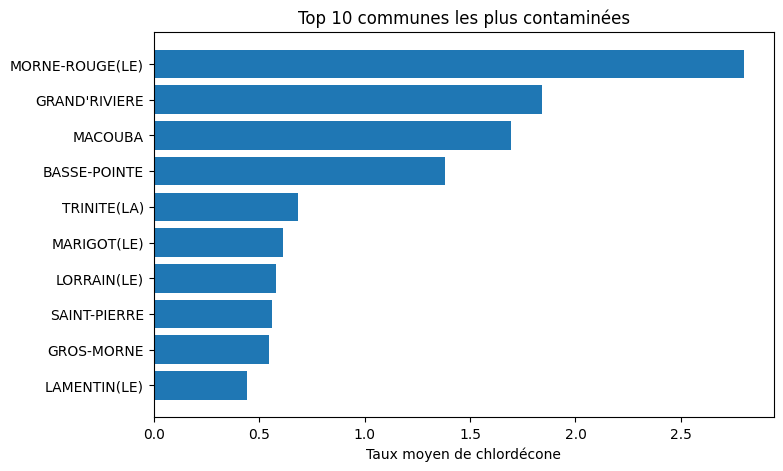

In [253]:
top10 = communes.head(10)

plt.figure(figsize=(8,5))
plt.barh(top10.index, top10["moyenne"])
plt.gca().invert_yaxis()
plt.xlabel("Taux moyen de chlordécone")
plt.title("Top 10 communes les plus contaminées")
plt.show()

L’analyse des concentrations moyennes par commune met en évidence une forte hétérogénéité territoriale. La commune du Morne-Rouge présente les niveaux moyens les plus élevés, avec une médiane proche de la moyenne, suggérant une contamination diffuse et homogène. À l’inverse, certaines communes comme Grand’Rivière présentent une forte différence entre moyenne et médiane, indiquant la présence de valeurs extrêmes.
Le taux de censure varie également significativement entre communes, traduisant une variabilité dans la distribution des concentrations sous limite de détection.

# Impact de l’historique banane sur la contamination

### La distribution par catégorie

In [254]:
df["histoBanane_cat"].value_counts()

histoBanane_cat
Inconnu    17983
1           6370
2           4697
3           2076
Name: count, dtype: int64

### Statistiques descriptives

In [255]:
df.groupby("histoBanane_cat")["Taux_Chlordecone_clean"].describe()

,count,mean,std,min,25%,50%,75%,max
histoBanane_cat,,,,,,,,
1,6370.0,0.992250,1.824551,0.0005,0.00165,0.14400,1.1700,17.35
2,4697.0,1.501895,2.169722,0.0005,0.02000,0.48000,2.3520,17.35
3,2076.0,1.737518,1.927163,0.0005,0.20400,0.84000,2.9000,9.90
Inconnu,17983.0,0.210203,0.902830,0.0005,0.00050,0.00165,0.0101,17.35


### Visualisation (boxplot comparatif)

<Figure size 700x500 with 0 Axes>

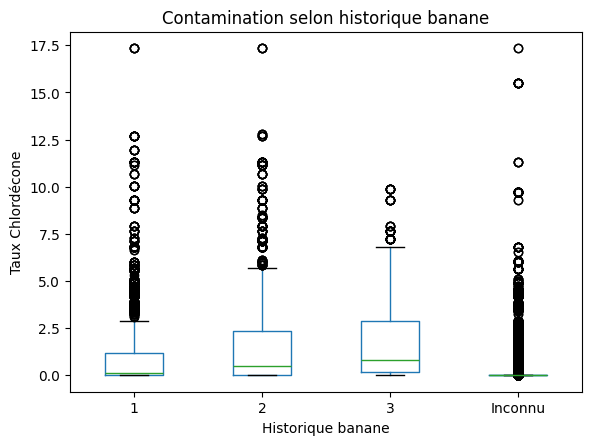

In [256]:
plt.figure(figsize=(7,5))

df.boxplot(column="Taux_Chlordecone_clean",
           by="histoBanane_cat",
           grid=False)

plt.title("Contamination selon historique banane")
plt.suptitle("")
plt.xlabel("Historique banane")
plt.ylabel("Taux Chlordécone")
plt.show()

#### log-transformée
Parce que la distribution est asymétrique :

<Figure size 700x500 with 0 Axes>

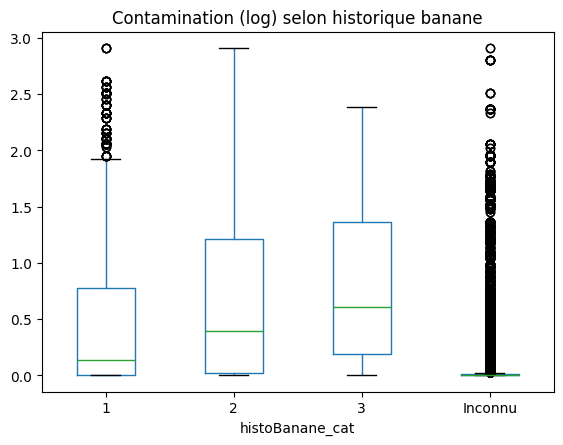

In [257]:
plt.figure(figsize=(7,5))

df.boxplot(column="log_chl",
           by="histoBanane_cat",
           grid=False)

plt.title("Contamination (log) selon historique banane")
plt.suptitle("")
plt.show()

L’analyse des concentrations (après transformation logarithmique) met en évidence une relation croissante entre l’intensité de l’historique bananier et les niveaux de contamination en chlordécone.
Les parcelles classées en catégorie 3 présentent des médianes nettement supérieures aux catégories 1 et 2, suggérant un effet dose-réponse cohérent avec l’usage historique du pesticide dans les cultures bananières.
Ce résultat renforce l’hypothèse d’un lien structurel entre pratiques agricoles passées et contamination actuelle des sols.

## Test ANOVA (sur variable log)
On exclut la catégorie "Inconnu" pour éviter de mélanger les situations.

In [258]:
from scipy import stats

# On garde seulement 1, 2, 3
df_test = df[df["histoBanane_cat"].isin(["1", "2", "3"])]

group1 = df_test[df_test["histoBanane_cat"] == "1"]["log_chl"].dropna()
group2 = df_test[df_test["histoBanane_cat"] == "2"]["log_chl"].dropna()
group3 = df_test[df_test["histoBanane_cat"] == "3"]["log_chl"].dropna()

anova_result = stats.f_oneway(group1, group2, group3)

anova_result

F_onewayResult(statistic=np.float64(256.2482639803734), pvalue=np.float64(6.73315090233199e-110))

Une analyse de variance (ANOVA) réalisée sur les concentrations log-transformées montre une différence hautement significative entre les catégories d’historique bananier (F = 256.25 ; p < 0.001). L’hypothèse d’égalité des moyennes est rejetée. Ce résultat confirme statistiquement l’existence d’un effet structurant de l’intensité historique de culture bananière sur la contamination actuelle des sols en chlordécone.

Analyse post-hoc (Tukey HSD)

In [259]:
from statsmodels.stats.multicomp import pairwise_tukeyhsd

tukey = pairwise_tukeyhsd(
    df_test["log_chl"],
    df_test["histoBanane_cat"],
    alpha=0.05
)

print(tukey)

Multiple Comparison of Means - Tukey HSD, FWER=0.05
group1 group2 meandiff p-adj lower  upper  reject
-------------------------------------------------
     1      2   0.1955   0.0 0.1666 0.2244   True
     1      3   0.3308   0.0 0.2929 0.3688   True
     2      3   0.1353   0.0 0.0957 0.1749   True
-------------------------------------------------


Le test post-hoc de Tukey confirme que toutes les comparaisons deux à deux entre les catégories d’historique bananier sont statistiquement significatives (p < 0.05). Les différences observées suivent une relation monotone croissante (1 < 2 < 3), ce qui renforce l’existence d’un effet dose-réponse entre l’intensité historique de culture bananière et la contamination en chlordécone.

## régression multiple

### Construction d'un dataset “modèle” propre

In [260]:
features = [
    "log_chl",
    "histoBanane_cat",
    "Sol_simple",
    "type_sol",
    "RAIN",
    "mnt_pente_mean",
    "mnt_tpi_mean",
    "mnt_tri_mean",
    "mnt_rugosite_mean",
    "mnt_ombrage_mean",
    "mnt_exposition_mean",
    "X","Y",
    "Taux_Chlordecone_clean", "COMMU_LAB"
]
df_model = df[features].dropna().copy()

### Régression multiple (OLS)
On utilise des variables catégorielles (C(...))

In [261]:
model = smf.ols(
    "log_chl ~ C(histoBanane_cat) + C(Sol_simple) + C(RAIN) + "
    "mnt_pente_mean + mnt_tpi_mean + mnt_tri_mean + mnt_rugosite_mean + "
    "mnt_ombrage_mean + mnt_exposition_mean",
    data=df_model
).fit()

print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                log_chl   R-squared:                       0.335
Model:                            OLS   Adj. R-squared:                  0.334
Method:                 Least Squares   F-statistic:                     773.8
Date:                Thu, 19 Feb 2026   Prob (F-statistic):               0.00
Time:                        16:58:08   Log-Likelihood:                -18718.
No. Observations:               30758   AIC:                         3.748e+04
Df Residuals:                   30737   BIC:                         3.765e+04
Df Model:                          20                                         
Covariance Type:            nonrobust                                         
                                    coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------------
Intercept     

Une régression linéaire multiple a été réalisée sur les concentrations log-transformées afin d’évaluer l’effet de l’historique bananier en contrôlant les facteurs environnementaux (type de sol, topographie, pluviométrie).
Le modèle explique 33 % de la variance observée (R² = 0.332).
Les catégories 2 et 3 d’historique bananier présentent des coefficients positifs et hautement significatifs (p < 0.001), confirmant que l’intensité historique de culture bananière demeure un facteur explicatif majeur de la contamination, indépendamment des caractéristiques environnementales.
En somme : La régression multiple a été utilisée afin d’isoler l’effet propre de l’historique bananier sur la contamination, en contrôlant les facteurs environnementaux susceptibles d’influencer les concentrations mesurées.

## Carte spatiale réelle

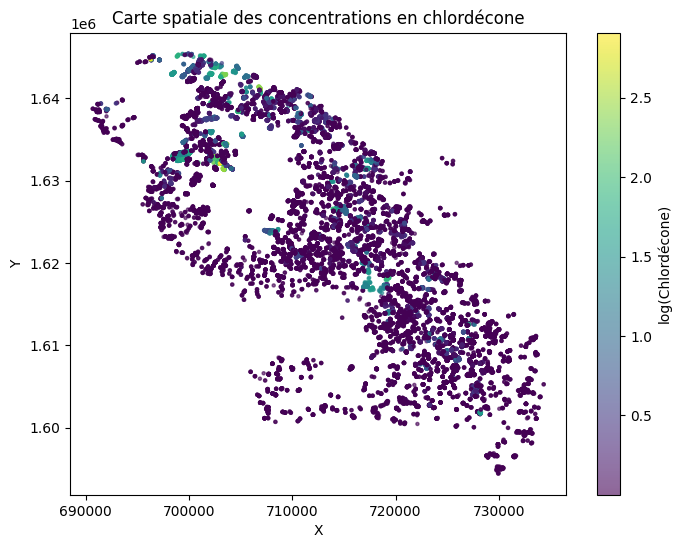

In [262]:
plt.figure(figsize=(8,6))

sc = plt.scatter(
    df["X"],
    df["Y"],
    c=df["log_chl"],
    s=5,
    alpha=0.6
)

plt.colorbar(sc, label="log(Chlordécone)")
plt.title("Carte spatiale des concentrations en chlordécone")
plt.xlabel("X")
plt.ylabel("Y")
plt.show()

In [263]:
# 1) Construire en UTM (pas 4326)
gdf = gpd.GeoDataFrame(
    df,
    geometry=gpd.points_from_xy(df["X"], df["Y"]),
    crs="EPSG:32620"   #  UTM zone 20N (Martinique)
)

# 2) Reprojeter en lat/lon
gdf = gdf.to_crs("EPSG:4326")
gdf["lon"] = gdf.geometry.x
gdf["lat"] = gdf.geometry.y

# 3) Carte interactive
fig = px.scatter_map(
    gdf,
    lat="lat",
    lon="lon",
    color="log_chl",
    zoom=9,
    height=650,
    title="Chlordécone (log) — Carte interactive",
    hover_name="COMMU_LAB",
    hover_data={
        "Taux_Chlordecone_clean": True,
        "log_chl": True,
        "histoBanane_cat": True,
        "RAIN": True,
        "Sol_simple": True,
        "type_sol": True
    }
)

fig.update_layout(map_style="open-street-map")
fig.show()

## Carte prédictive

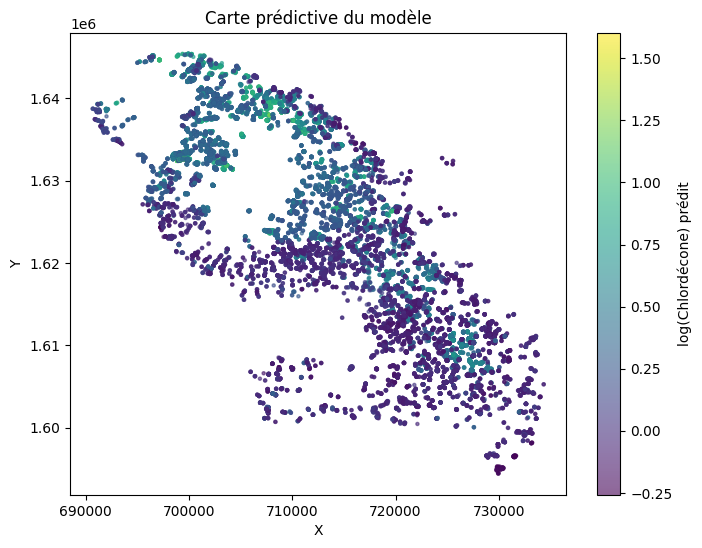

In [264]:
df_model["prediction"] = model.predict(df_model)

plt.figure(figsize=(8,6))

sc = plt.scatter(
    df_model["X"],
    df_model["Y"],
    c=df_model["prediction"],
    s=5,
    alpha=0.6
)

plt.colorbar(sc, label="log(Chlordécone) prédit")
plt.title("Carte prédictive du modèle")
plt.xlabel("X")
plt.ylabel("Y")
plt.show()

In [265]:
import geopandas as gpd

gdf_pred = gpd.GeoDataFrame(
    df_model,
    geometry=gpd.points_from_xy(df_model["X"], df_model["Y"]),
    crs="EPSG:32620"   # UTM 20N (Martinique)
).to_crs("EPSG:4326")

gdf_pred["lon"] = gdf_pred.geometry.x
gdf_pred["lat"] = gdf_pred.geometry.y

fig_map = px.scatter_map(
    gdf_pred,
    lat="lat",
    lon="lon",
    color="prediction",
    color_continuous_scale="Viridis",
    zoom=9,
    height=700,
    title="Carte prédictive (OLS) — sur fond OpenStreetMap",
    hover_name="COMMU_LAB",
    hover_data={
        "Taux_Chlordecone_clean": True,
        "log_chl": True,
        "prediction": True,
        "histoBanane_cat": True
    }
)
fig_map.update_layout(map_style="open-street-map")
fig_map.show()

In [266]:
import numpy as np
import plotly.express as px

# Résidu = observé - prédit (sur l'échelle log)
gdf_pred["residu"] = gdf_pred["log_chl"] - gdf_pred["prediction"]

# Pour une échelle de couleur plus lisible : on borne aux percentiles
lo, hi = np.nanpercentile(gdf_pred["residu"], [2, 98])
gdf_pred["residu_clip"] = gdf_pred["residu"].clip(lo, hi)

fig_res_map = px.scatter_map(
    gdf_pred,
    lat="lat",
    lon="lon",
    color="residu_clip",
    color_continuous_scale="RdBu",
    color_continuous_midpoint=0,   # centre sur 0 (sur/sous-estimation)
    zoom=9,
    height=700,
    title="Carte des résidus (observé - prédit) sur OpenStreetMap",
    hover_name="COMMU_LAB",
    hover_data={
        "Taux_Chlordecone_clean": True,
        "log_chl": True,
        "prediction": True,
        "residu": True,
        "histoBanane_cat": True,
        "RAIN": True,
        "Sol_simple": True
    }
)

fig_res_map.update_layout(
    map_style="open-street-map",
    margin=dict(l=0, r=0, t=50, b=0),
    coloraxis_colorbar=dict(title="Résidu (log)")
)

# Centre/zoom auto (optionnel)
fig_res_map.update_layout(
    map_center={"lat": gdf_pred["lat"].mean(), "lon": gdf_pred["lon"].mean()},
    map_zoom=10
)

fig_res_map.show()

Résidu > 0 : contamination observée plus élevée que prévue alors le modèle sous-estime (facteurs manquants possibles).

Résidu < 0 : contamination observée plus faible que prévue alors le modèle surestime.

## Mini-analyse structurée des zones où le modèle se trompe le plus.

### Top communes avec plus forte erreur moyenne

In [267]:
# Erreur absolue moyenne par commune
erreur_commune = (
    gdf_pred
    .groupby("COMMU_LAB")
    .agg(
        n_obs=("residu", "count"),
        erreur_moy_abs=("residu", lambda x: np.mean(np.abs(x))),
        residu_moy=("residu", "mean")
    )
    .sort_values("erreur_moy_abs", ascending=False)
)

erreur_commune.head(10)

,n_obs,erreur_moy_abs,residu_moy
COMMU_LAB,,,
MORNE-ROUGE(LE),3725,0.670229,0.417693
GRAND'RIVIERE,125,0.574752,0.092522
BASSE-POINTE,992,0.475127,0.118342
LORRAIN(LE),1749,0.471112,-0.285468
MACOUBA,698,0.409910,0.295513
MARIGOT(LE),475,0.373276,-0.117296
GROS-MORNE,2093,0.341098,-0.128533
TRINITE(LA),1101,0.321215,0.017148
SAINTE-MARIE,1406,0.307707,-0.166024


### Par type de sol

In [268]:
erreur_sol = (
    gdf_pred
    .groupby("Sol_simple")
    .agg(
        n_obs=("residu", "count"),
        erreur_moy_abs=("residu", lambda x: np.mean(np.abs(x))),
        residu_moy=("residu", "mean")
    )
    .sort_values("erreur_moy_abs", ascending=False)
)

erreur_sol.head(10)

,n_obs,erreur_moy_abs,residu_moy
Sol_simple,,,
Andosol,10857,0.474057,-1.120902e-14
No data,2577,0.447334,9.441441e-15
"Alluvium, Colluvium",1570,0.247985,-1.132374e-14
Nitisol,3005,0.210266,1.015826e-16
Vertisol,6909,0.196983,-6.706502e-15
Ferralsol,5128,0.186687,6.142250e-15
Urban area,712,0.169227,-1.852568e-15


### Les 10 parcelles les plus mal prédites

In [269]:
top_erreurs = (
    gdf_pred
    .assign(erreur_abs=lambda x: np.abs(x["residu"]))
    .sort_values("erreur_abs", ascending=False)
)

top_erreurs[[
    "COMMU_LAB",
    "Taux_Chlordecone_clean",
    "prediction",
    "residu",
    "histoBanane_cat",
    "Sol_simple",
    "RAIN"
]].head(10)

,COMMU_LAB,Taux_Chlordecone_clean,prediction,residu,histoBanane_cat,Sol_simple,RAIN
21145,MORNE-ROUGE(LE),17.350,0.293346,2.616284,Inconnu,Andosol,2000-3000
21146,MORNE-ROUGE(LE),17.350,0.412046,2.497583,Inconnu,Andosol,3000-5000
14739,GRAND'RIVIERE,15.515,0.316426,2.487843,Inconnu,Andosol,2000-3000
14736,GRAND'RIVIERE,15.515,0.321794,2.482475,Inconnu,Andosol,2000-3000
14735,GRAND'RIVIERE,15.515,0.321794,2.482475,Inconnu,Andosol,2000-3000
21144,GRAND'RIVIERE,15.515,0.327140,2.477129,Inconnu,Andosol,2000-3000
21143,GRAND'RIVIERE,15.515,0.339426,2.464843,Inconnu,Andosol,2000-3000
14738,GRAND'RIVIERE,15.515,0.345776,2.458493,Inconnu,Andosol,2000-3000
14737,GRAND'RIVIERE,15.515,0.363374,2.440895,Inconnu,No data,2000-3000
21142,GRAND'RIVIERE,15.515,0.372455,2.431814,Inconnu,No data,2000-3000


L’analyse des résidus permet d’identifier les zones où le modèle sous-estime ou surestime la contamination.
Certaines communes présentent une erreur moyenne plus élevée, suggérant la présence de facteurs locaux non capturés par les variables intégrées (par exemple pratiques agricoles spécifiques, micro-topographie, ou historiques d’usage différenciés).
Cette analyse met en évidence les limites du modèle linéaire et suggère des pistes d’amélioration futures.

## Random Forest (ML) end-to-end

In [270]:

import sklearn
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score, mean_squared_error


# 1) Features (cat + num) + cible
ml_features = [
    "histoBanane_cat",
    "Sol_simple",
    "type_sol",
    "RAIN",
    "mnt_pente_mean",
    "mnt_tpi_mean",
    "mnt_tri_mean",
    "mnt_rugosite_mean",
    "mnt_ombrage_mean",
    "mnt_exposition_mean",
]

target = "log_chl"

# 2) Dataset ML (drop NA)
df_ml = df[ml_features + [target]].dropna().copy()

# 3) One-Hot Encoding des catégorielles
df_ml_encoded = pd.get_dummies(df_ml, drop_first=True)

# 4) Séparation X / y
X = df_ml_encoded.drop(columns=[target])
y = df_ml_encoded[target]

# 5) Train/test split
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.30, random_state=42
)

# 6) Modèle Random Forest
rf = RandomForestRegressor(
    n_estimators=200,
    random_state=42,
    n_jobs=-1
)

rf.fit(X_train, y_train)

# 7) Prédiction + métriques
y_pred = rf.predict(X_test)

r2 = r2_score(y_test, y_pred)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))

print(f"R² (test)  : {r2:.3f}")
print(f"RMSE (test): {rmse:.3f}")

# 8) Importances (top 15)
importances = (
    pd.Series(rf.feature_importances_, index=X.columns)
      .sort_values(ascending=False)
)

print("\nTop 15 features (importance):")
print(importances.head(15))

R² (test)  : 0.705
RMSE (test): 0.297

Top 15 features (importance):
histoBanane_cat_Inconnu                               0.182530
mnt_exposition_mean                                   0.122501
Sol_simple_Andosol                                    0.098079
mnt_tpi_mean                                          0.093632
mnt_tri_mean                                          0.093478
mnt_ombrage_mean                                      0.091151
mnt_rugosite_mean                                     0.077960
mnt_pente_mean                                        0.067609
Sol_simple_No data                                    0.040302
type_sol_Sols … allophane relativement ‚volu‚s        0.022203
histoBanane_cat_3                                     0.018870
histoBanane_cat_2                                     0.015005
type_sol_Sols … allophane relativement peu ‚volu‚s    0.014308
type_sol_Sols peu ‚volu‚s sur cendres                 0.008635
RAIN_2000-3000                                   

Le modèle Random Forest a été entraîné afin de capturer d’éventuelles non-linéarités et interactions complexes entre les variables environnementales.
Le modèle obtient un R² de 0.705 sur l’échantillon test, soit plus du double du modèle linéaire (R² ≈ 0.33).
Cela suggère que la contamination dépend de relations non linéaires entre l’historique agricole, la topographie et les caractéristiques des sols.
L’historique bananier demeure l’une des variables les plus influentes, confirmant son rôle central.

## Carte interactive de risque

In [271]:
# Utiliser les prédictions Random Forest
df_ml_full = df[ml_features + ["log_chl", "X", "Y", "COMMU_LAB"]].dropna().copy()

# Encodage identique
df_ml_full_encoded = pd.get_dummies(df_ml_full[ml_features], drop_first=True)

# Aligner colonnes avec X du modèle entraîné
df_ml_full_encoded = df_ml_full_encoded.reindex(columns=X.columns, fill_value=0)

# Prédiction ML
df_ml_full["rf_prediction"] = rf.predict(df_ml_full_encoded)

# Classification par quantiles
df_ml_full["risk_class"] = pd.qcut(
    df_ml_full["rf_prediction"],
    q=3,
    labels=["Faible", "Modéré", "Élevé"]
)

df_ml_full.head()

,histoBanane_cat,Sol_simple,type_sol,RAIN,mnt_pente_mean,mnt_tpi_mean,mnt_tri_mean,mnt_rugosite_mean,mnt_ombrage_mean,mnt_exposition_mean,log_chl,X,Y,COMMU_LAB,rf_prediction,risk_class
0,2,Andosol,Intergrades Sols … allophane relativement ‚vol...,2000-3000,39.043098,5.805967,8.033367,21.593658,131.173998,79.447954,1.722767,714300.831892,1.626344e+06,GROS-MORNE,1.605154,Élevé
1,2,Andosol,Intergrades Sols … allophane relativement ‚vol...,2000-3000,38.123675,5.683589,7.920563,20.944901,134.608205,76.985690,1.722767,714303.743345,1.626354e+06,GROS-MORNE,1.644461,Élevé
2,3,Andosol,Intergrades Sols … allophane relativement ‚vol...,2000-3000,34.976678,2.239457,7.108432,20.085883,139.420523,76.064719,1.722767,714309.446765,1.626360e+06,GROS-MORNE,1.518554,Élevé
3,1,Andosol,Intergrades Sols … allophane relativement ‚vol...,2000-3000,38.315796,4.038373,7.530090,23.427731,121.603678,92.392454,1.722767,714294.208512,1.626321e+06,GROS-MORNE,0.865832,Élevé
4,2,Andosol,Intergrades Sols … allophane relativement ‚vol...,2000-3000,33.877727,0.596502,6.637082,20.153770,134.065066,83.930611,1.722767,714303.823058,1.626341e+06,GROS-MORNE,1.453537,Élevé


In [272]:
gdf_risk = gpd.GeoDataFrame(
    df_ml_full,
    geometry=gpd.points_from_xy(df_ml_full["X"], df_ml_full["Y"]),
    crs="EPSG:32620"
).to_crs("EPSG:4326")

gdf_risk["lon"] = gdf_risk.geometry.x
gdf_risk["lat"] = gdf_risk.geometry.y

fig_risk = px.scatter_map(
    gdf_risk,
    lat="lat",
    lon="lon",
    color="risk_class",
    zoom=9,
    height=700,
    title="Carte de risque — Modèle Random Forest",
    hover_data=["rf_prediction", "log_chl"]
)

fig_risk.update_layout(map_style="open-street-map")
fig_risk.show()

# Traduction la carte en décision publique

### Agrégation par commune du risque ML

In [273]:
commune_risk = (
    gdf_risk
.groupby("COMMU_LAB")
    .agg(
        n_obs=("rf_prediction", "count"),
        risk_eleve=("risk_class", lambda x: (x == "Élevé").mean()),
        risk_modere=("risk_class", lambda x: (x == "Modéré").mean()),
        prediction_moy=("rf_prediction", "mean")
    )
    .sort_values("risk_eleve", ascending=False)
)

commune_risk.head(10)

,n_obs,risk_eleve,risk_modere,prediction_moy
COMMU_LAB,,,,
MACOUBA,698,0.876791,0.123209,0.826214
GRAND'RIVIERE,125,0.728000,0.216000,0.573676
MORNE-ROUGE(LE),3725,0.717852,0.194094,0.984781
MARIGOT(LE),475,0.566316,0.261053,0.372044
LORRAIN(LE),1749,0.527158,0.409949,0.369410
BASSE-POINTE,992,0.488911,0.359879,0.532998
SAINT-PIERRE,339,0.460177,0.262537,0.333979
TRINITE(LA),1101,0.444142,0.326067,0.381387
AJOUPA BOUILLON,1037,0.350048,0.326905,0.232804


### Visualisation Top 10 communes prioritaires

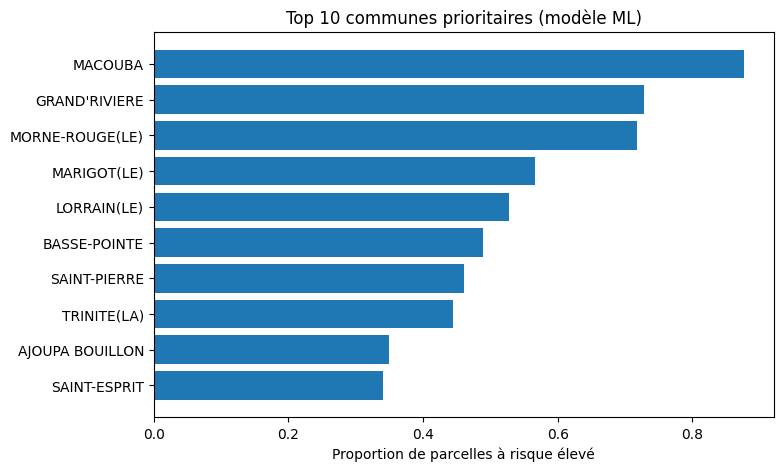

In [274]:
top10_risk = commune_risk.head(10)

import matplotlib.pyplot as plt

plt.figure(figsize=(8,5))
plt.barh(top10_risk.index[::-1], top10_risk["risk_eleve"][::-1])
plt.xlabel("Proportion de parcelles à risque élevé")
plt.title("Top 10 communes prioritaires (modèle ML)")
plt.show()

La classification issue du modèle Random Forest met en évidence une forte concentration de parcelles à risque élevé dans plusieurs communes du Nord de l’île, notamment Macouba, Grand’Rivière et Morne-Rouge. 
Dans ces territoires, plus de 70 % des parcelles analysées sont classées à haut risque. 
Cette structuration spatiale est cohérente avec l’historique agricole et les caractéristiques pédologiques identifiées précédemment. 
Ces résultats suggèrent que les actions de surveillance environnementale et de gestion des sols devraient être priorisées dans ces zones.

### Comparaison analyse descriptive vs modélisation
L’analyse descriptive initiale, basée sur les concentrations moyennes par commune, identifiait déjà Morne-Rouge, Grand’Rivière et Macouba comme les territoires les plus contaminés. La modélisation prédictive par Random Forest confirme la concentration du risque dans ces mêmes communes, tout en affinant la hiérarchisation territoriale. Cette convergence entre approche descriptive et approche modélisée renforce la solidité des résultats obtenus.

# Conclusion générale
## Synthèse des résultats
Ce projet avait pour objectif de structurer, analyser et modéliser des données environnementales relatives à la contamination des sols par la chlordécone aux Antilles françaises. À travers un pipeline complet d’ingénierie des données, depuis le nettoyage jusqu’à la modélisation prédictive, plusieurs résultats majeurs ont été mis en évidence.

L’analyse descriptive initiale a révélé une forte hétérogénéité territoriale des concentrations, avec certaines communes du nord de l’île (notamment Morne-Rouge, Grand’Rivière et Macouba) présentant des niveaux moyens significativement plus élevés.

L’analyse statistique (ANOVA et tests post-hoc) a confirmé l’existence d’un effet significatif de l’historique bananier sur les niveaux de contamination, suggérant une relation dose-réponse entre l’intensité des pratiques agricoles passées et la contamination actuelle.

La régression linéaire multiple a permis d’isoler l’effet propre de l’historique agricole en contrôlant les facteurs environnementaux (type de sol, topographie, pluviométrie). Le modèle explique environ 33 % de la variance observée, confirmant que la contamination est multifactorielle.

Enfin, la modélisation non linéaire par Random Forest a considérablement amélioré la performance prédictive (R² ≈ 0.70), révélant l’existence d’interactions complexes entre historique agricole, caractéristiques pédologiques et paramètres topographiques. L’historique bananier demeure l’une des variables les plus influentes, ce qui confirme son rôle structurant dans la distribution spatiale de la contamination.

## Apports pour l’aide à la décision
La construction d’une carte de risque basée sur le modèle prédictif permet de hiérarchiser les territoires selon leur probabilité de contamination élevée. Cette approche met en évidence une concentration du risque dans plusieurs communes du nord de l’île, où une proportion importante de parcelles est classée à haut risque.

Ces résultats suggèrent :

    la priorisation des actions de surveillance environnementale dans les zones identifiées,

    le renforcement des dispositifs d’accompagnement agricole dans les territoires à forte exposition,

    la nécessité d’intégrer des variables micro-territoriales supplémentaires dans les analyses futures.
## Limites et perspectives
Malgré des performances prédictives élevées, certaines limites subsistent :

    présence de valeurs censurées sous le seuil de détection,

    données manquantes pour certaines variables historiques,

    absence de variables socio-économiques ou hydrologiques fines.

Des travaux futurs pourraient intégrer des modèles spatiaux avancés (krigeage, modèles géostatistiques), ainsi que des données hydrologiques détaillées afin d’affiner la compréhension des mécanismes de diffusion.
## Conclusion finale
L’ensemble des analyses confirme que la contamination actuelle des sols par la chlordécone est fortement structurée par les pratiques agricoles historiques, mais également modulée par les caractéristiques environnementales locales. La combinaison d’approches statistiques explicatives et de modèles prédictifs non linéaires permet d’obtenir une vision à la fois interprétable et opérationnelle du risque environnemental.
